In [1]:
import sys
sys.path.append("../")

import time

import yaml
import pickle
from pathlib import Path
import jax.numpy as np

import optax
import jax
from numpyro import optim
from numpyro.infer import SVI, Trace_ELBO, autoguide
from ml_collections.config_dict import ConfigDict

from models.diffusion import VariationalDiffusionModel
from models.diffusion_utils import generate, variance_preserving_map,alpha,sigma2
from datasets import get_nbody_data
from models.periodic_boundary_utils import apply_pbc
from models.graph_utils import nearest_neighbors

/n/home11/ccuestalazaro/.conda/envs/diffjax/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2023-05-18 13:58:04.202446: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /n/helmod/apps/centos7/Core/glib/2.56.1-fasrc01/lib64:/n/helmod/apps/centos7/Core/gcc/12.1.0-fasrc01/lib64:/n/helmod/apps/centos7/Core/gcc/12.1.0-fasrc01/lib:/n/helmod/apps/centos7/Core/cudnn/8.5.0.96_cuda11-fasrc01/lib:/n/helmod/apps/centos7/Core/cuda/11.7.1-fasrc01/cuda/extras/CUPTI/lib64:/n/helmod/apps/centos7/Core/cuda/11.7.1-fasrc01/cuda/lib64:/n/helmod/apps/centos7/Core/cuda/11.7.1-fasrc01/cuda/lib:/n/helmod/apps/centos7/Core/mpc/1.2.1-fasrc01/lib64:/n/he

In [2]:
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize


In [3]:
run_name = 'sandy-bee-180' #sweet-smoke-166
path_to_model = Path(
    f"/n/home11/ccuestalazaro/set-diffuser/logging/cosmology/{run_name}"
)
vdm_pbc, restored_params_pbc = VariationalDiffusionModel.from_path_to_model(
    path_to_model=path_to_model
)

In [4]:
run_name = 'desert-cosmos-183' #sweet-smoke-166
path_to_model = Path(
    f"/n/home11/ccuestalazaro/set-diffuser/logging/cosmology/{run_name}"
)
vdm, restored_params = VariationalDiffusionModel.from_path_to_model(
    path_to_model=path_to_model
)

In [5]:
x_test, mask_test, conditioning_test, norm_dict = get_nbody_data(
    n_features=3,
    n_particles=5000,
    split='train',
    normalize=False,
    standarize=True,
)

Text(0, 0.5, 'alpha')

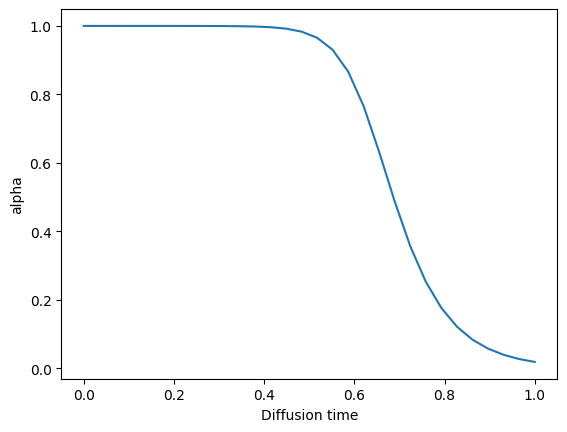

In [36]:
alphat = []
for t in times:
    gt = vdm_pbc.apply(restored_params_pbc, t, method=vdm.gammat)
    alphat.append(alpha(gt))


plt.plot(
    times,
    alphat,
)
plt.xlabel('Diffusion time')
plt.ylabel('alpha')

In [6]:
def get_noise(vdm, restored_params, sample, conditioning, mask, eps, times):
    noisy_samples, noise_prediction = [], []
    for i, t in enumerate(times):
        gt = vdm.apply(restored_params, t, method=vdm.gammat)
        z_noisy = variance_preserving_map(sample, gt, eps)
        if vdm.apply_pbcs:
            z_noisy = vdm.apply(
                restored_params, 
                z_noisy, 
                method=vdm.wrap_z_in_periodic_box,
            )
        noisy_samples.append(
            z_noisy
        )

        score_pred = vdm.apply(
            restored_params, 
            z_noisy.reshape((1,5000,3)),
            gt,
            conditioning.reshape(1,-1),
            mask.reshape((1,5000,)),
            box_size=vdm.norm_dict['box_size'],
            method=vdm.evaluate_score,
        )
        noise_prediction.append(score_pred)
    return noisy_samples, noise_prediction




In [25]:
sample_idx = 100
sample = x_test[sample_idx]
conditioning = conditioning_test[sample_idx]
mask = mask_test[sample_idx]

times = np.linspace(0, 1, 30)
eps = jax.random.normal(jax.random.PRNGKey(0), sample.shape)

noisy_samples, noise_prediction = get_noise(
    vdm=vdm, 
    restored_params=restored_params,
    sample=sample,
    conditioning=conditioning,
    mask=mask,
    eps=eps,
    times=times,
)

In [26]:
noisy_samples, noise_prediction = get_noise(
    vdm=vdm, 
    restored_params=restored_params,
    sample=sample,
    conditioning=conditioning,
    mask=mask,
    eps=eps,
    times=times,
)

In [27]:
noisy_pbc_samples, noise_pbc_prediction = get_noise(
    vdm=vdm_pbc, 
    restored_params=restored_params_pbc,
    sample=sample,
    conditioning=conditioning,
    mask=mask,
    eps=eps,
    times=times,
)

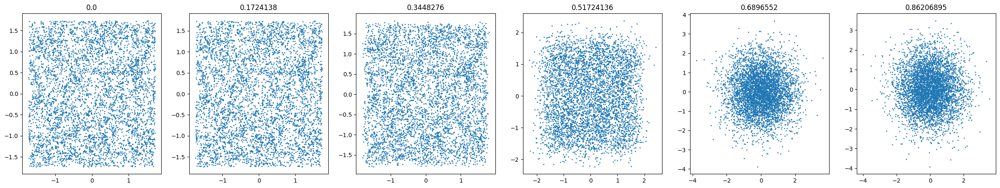

In [28]:
fig, ax = plt.subplots(ncols=len(range(0,len(times),5)),
                       figsize=(len(range(0,len(times),5))*5,5))

for i, j in enumerate(range(0,len(times),5)):
    ax[i].set_title(times[j])
    ax[i].scatter(
        noisy_samples[j][:,0], 
        noisy_samples[j][:,1],
        s=1,
    )

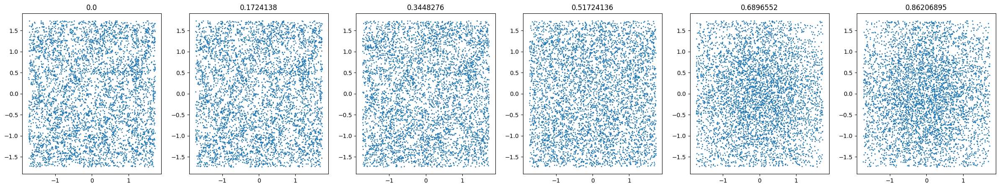

In [29]:
fig, ax = plt.subplots(ncols=len(range(0,len(times),5)),
                       figsize=(len(range(0,len(times),5))*5,5))

for i, j in enumerate(range(0,len(times),5)):
    ax[i].set_title(times[j])

    ax[i].scatter(
        noisy_pbc_samples[j][:,0], 
        noisy_pbc_samples[j][:,1],
        s=1,
    )

In [30]:
def get_error(vdm, restored_params, noise_prediction, true_noise, time):
    deps = true_noise - noise_prediction
    if vdm.apply_pbcs:
        gt = vdm.apply(restored_params, time, method=vdm.gammat)
        deps = vdm.wrap_errors_in_periodic_box(
            errors=deps,
            sigma_t = np.sqrt(sigma2(gt))
        )
    return np.square(deps)

In [31]:
errors_time = []
for i, time in enumerate(times):
    errors_time.append(
        get_error(
            vdm,
            restored_params,
            noise_prediction[i],
            true_noise=eps,
            time=time,
        )
    )
errors_time = np.array(errors_time)

In [32]:
errors_pbc_time = []
for i, time in enumerate(times):
    errors_pbc_time.append(
        get_error(
            vdm_pbc,
            restored_params_pbc,
            noise_pbc_prediction[i],
            true_noise=eps,
            time=time,
        )
    )
errors_pbc_time = np.array(errors_pbc_time)

Text(0.5, 0, 'Time')

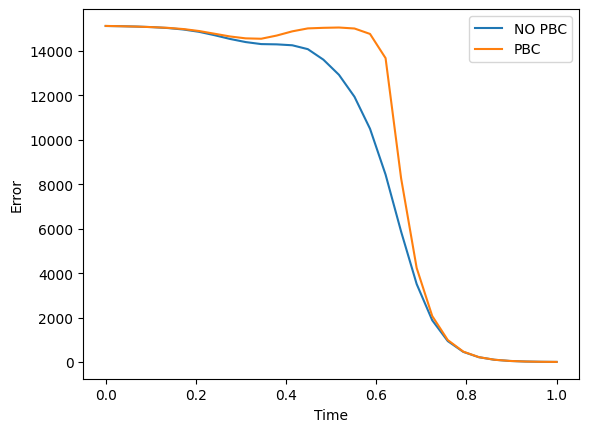

In [33]:
plt.plot(times, errors_time.sum((-1,-2)), label='NO PBC')
plt.plot(times, errors_pbc_time.sum((-1,-2)), label='PBC')
plt.legend()
plt.ylabel('Error')
plt.xlabel('Time')

/n/home11/ccuestalazaro/tmp/ipykernel_57179/4197494243.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  _ = cbar.ax.set_yticklabels(


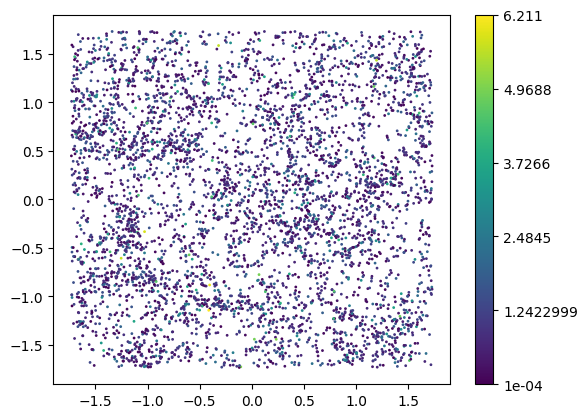

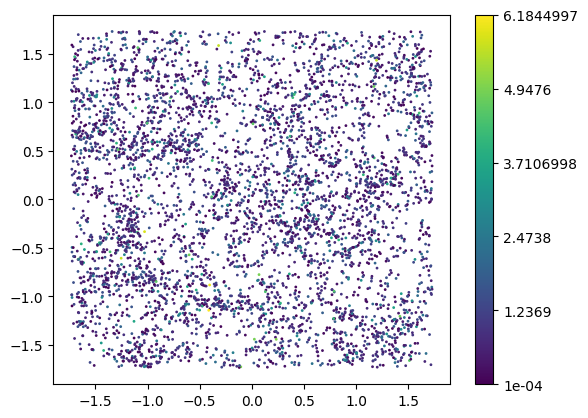

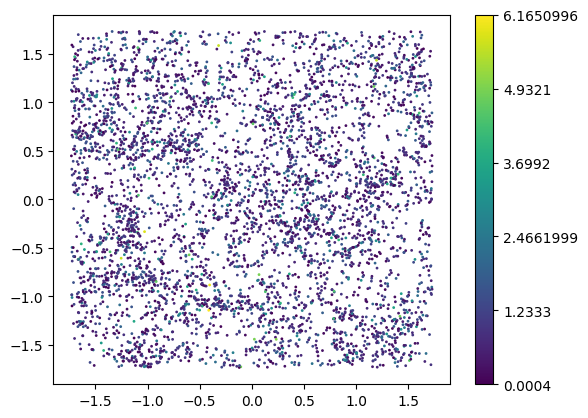

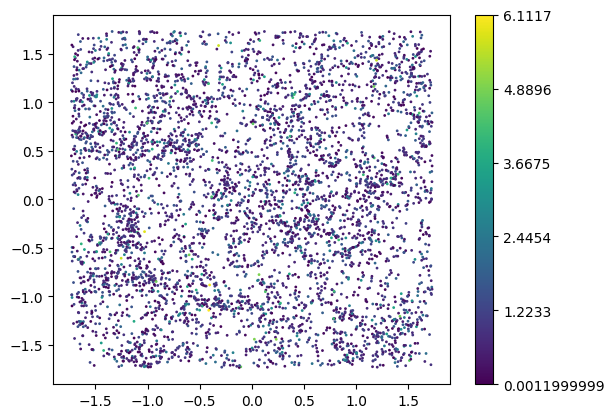

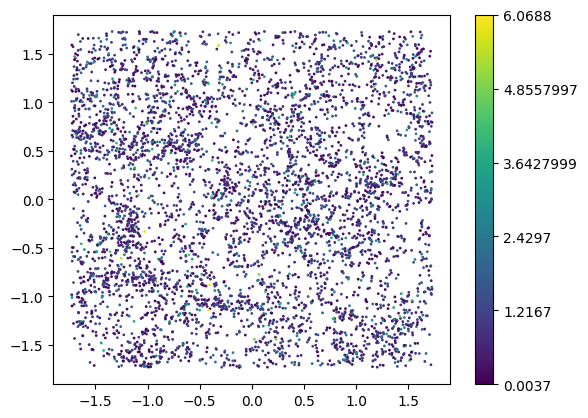

...

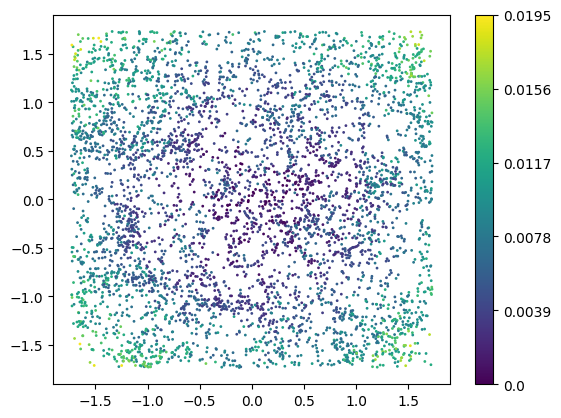

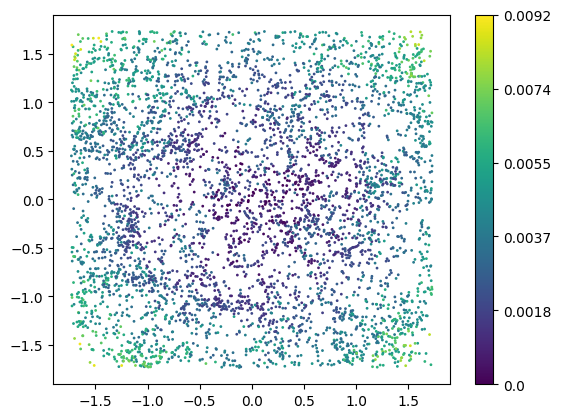

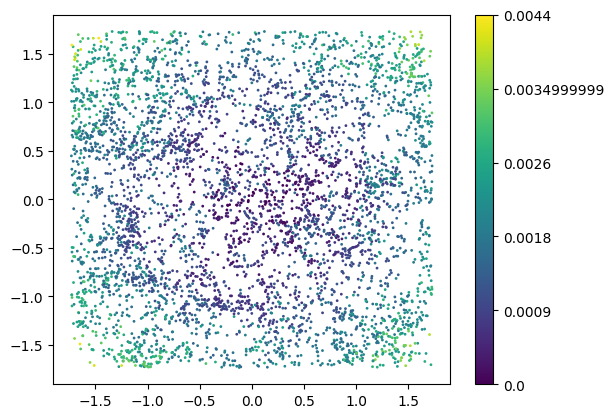

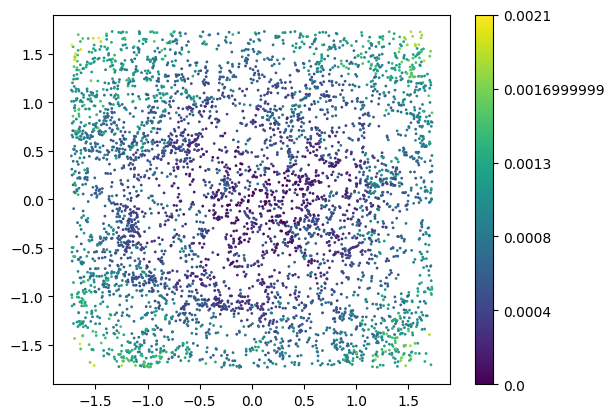

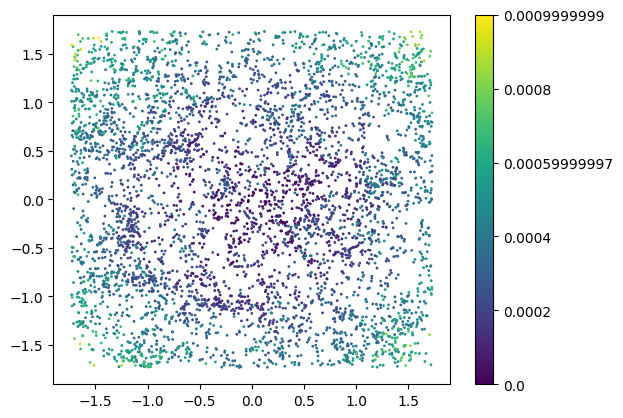

In [16]:
for idx in range(len(times)):
    err = errors_time[idx].mean(axis=-1)
    norm = Normalize(vmin=err.min(), vmax=err.max())
    normalized_color_variable = norm(err)
    sc = plt.scatter(
        sample[:,0],
        sample[:,1],
        s=1,
        c=normalized_color_variable,
        cmap='viridis'

    )

    cbar = plt.colorbar(sc)

    _ = cbar.ax.set_yticklabels(
        np.round(np.linspace(err.min(),err.max(), num=6),4)
    )
    plt.show()




/n/home11/ccuestalazaro/tmp/ipykernel_57179/1357372468.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  _ = cbar.ax.set_yticklabels(


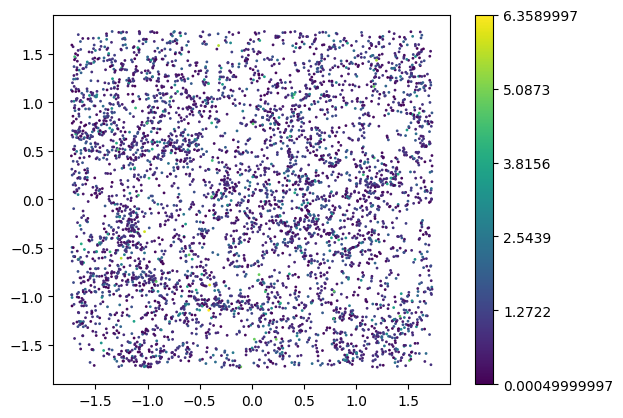

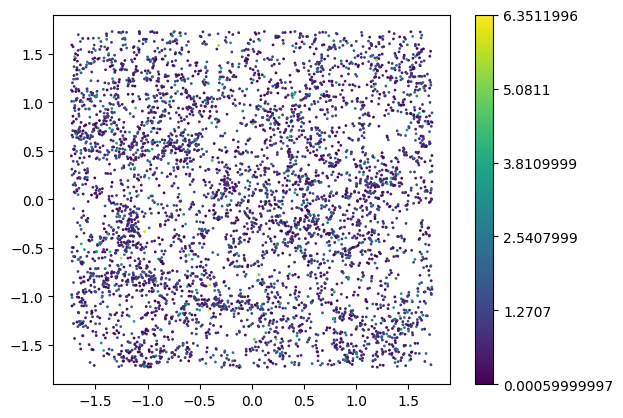

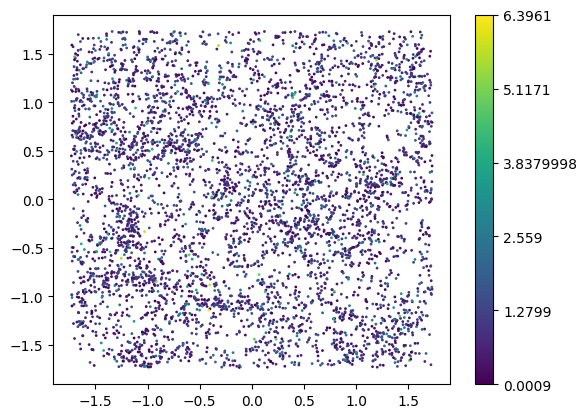

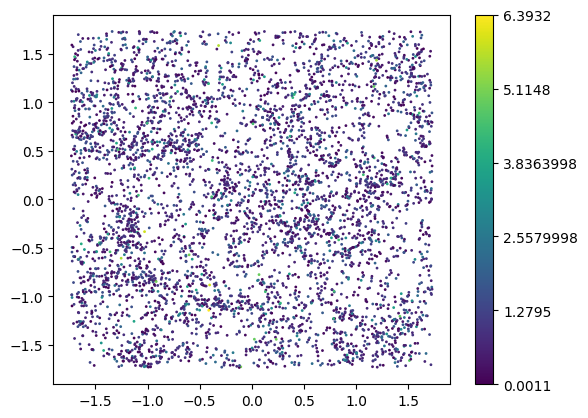

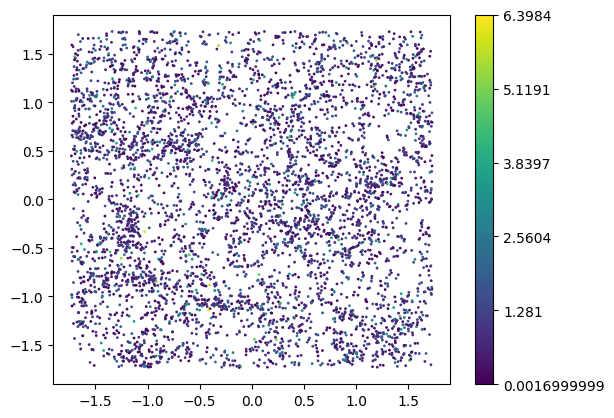

...

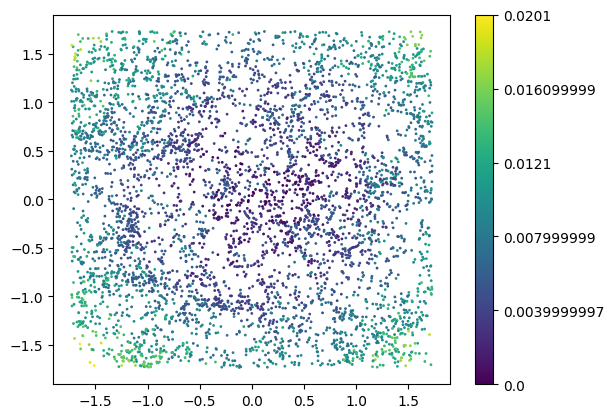

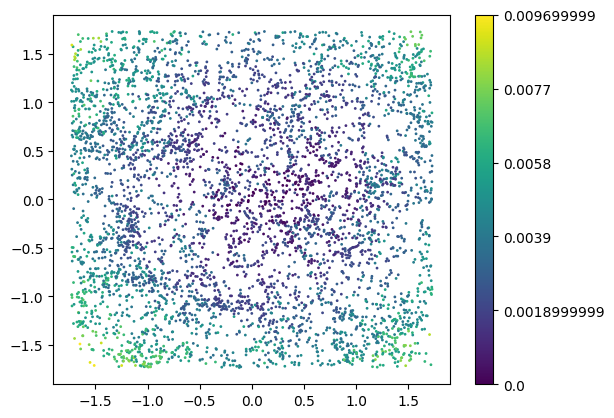

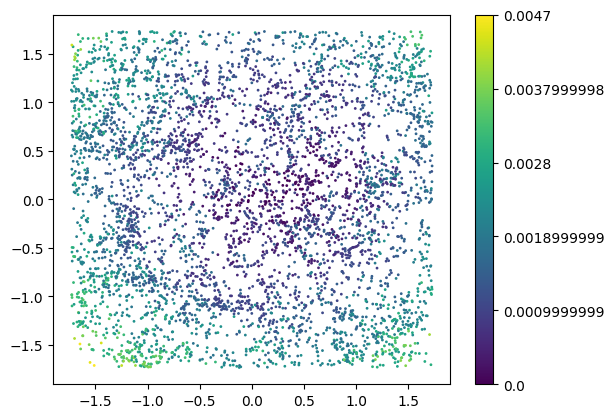

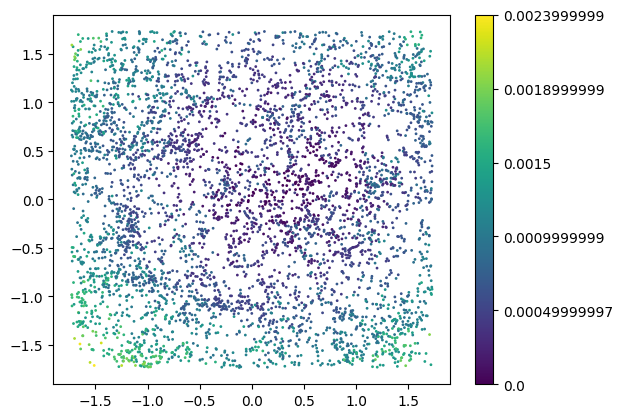

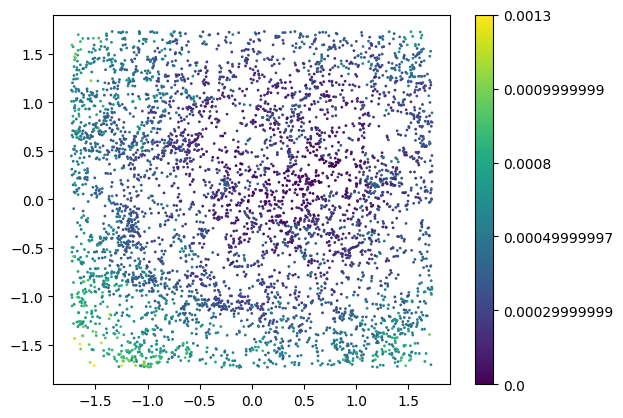

In [17]:
for idx in range(len(times)):
    err = errors_pbc_time[idx].mean(axis=-1)
    norm = Normalize(vmin=err.min(), vmax=err.max())
    normalized_color_variable = norm(err)
    sc = plt.scatter(
        sample[:,0],
        sample[:,1],
        s=1,
        c=normalized_color_variable,
        cmap='viridis'

    )

    cbar = plt.colorbar(sc)

    _ = cbar.ax.set_yticklabels(
        np.round(np.linspace(err.min(),err.max(), num=6),4)
    )
    plt.show()



In [18]:
n_samples = 2
rng = jax.random.PRNGKey(120)



In [19]:
def generate_sample(vdm, restored_params, rng, n_samples, conditioning, mask, steps=100):
    shape = (n_samples, 5000) 
    conditioning = np.tile(conditioning, (n_samples,1))
    mask = np.ones(shape) 
    rng, spl = jax.random.split(rng)
    zt = jax.random.normal(
        spl, 
        shape + (vdm.encdec_dict["d_embedding"] if vdm.use_encdec else vdm.d_feature,)
    )
    if vdm.apply_pbcs:
        zt = vdm.apply(
                restored_params, 
                zt, 
                method=vdm.wrap_z_in_periodic_box,
        )
    z_ts = [zt,]
    for i in range(0,steps):
        zt = vdm.apply(
            restored_params, rng, i, steps, zt, 
            conditioning, mask=mask, method=vdm.sample_step,
        )
        if vdm.apply_pbcs:
            zt = vdm.apply(
                    restored_params, 
                    zt, 
                    method=vdm.wrap_z_in_periodic_box,
            )
        z_ts.append(zt)
    g0 = vdm.apply(restored_params, 0.0, method=vdm.gammat)
    var0 = sigma2(g0)
    z0_rescaled = z_ts[-1] / np.sqrt(1.0 - var0)
    x = vdm.apply(restored_params, z0_rescaled, conditioning, method=vdm.decode)
    return z_ts, x.mean()

In [20]:
zts , gen_sample = generate_sample(
    vdm=vdm,
    restored_params=restored_params,
    rng=rng,
    n_samples=n_samples,
    conditioning = conditioning_test[0],
    mask=mask_test[0]
)

In [21]:
zts_pbc , gen_sample_pbc = generate_sample(
    vdm=vdm_pbc,
    restored_params=restored_params_pbc,
    rng=rng,
    n_samples=n_samples,
    conditioning = conditioning_test[0],
    mask=mask_test[0]
)

In [22]:
zts[0].shape

(2, 5000, 3)

/n/home11/ccuestalazaro/tmp/ipykernel_57179/3770240310.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(ncols=2, figsize=(10,5))


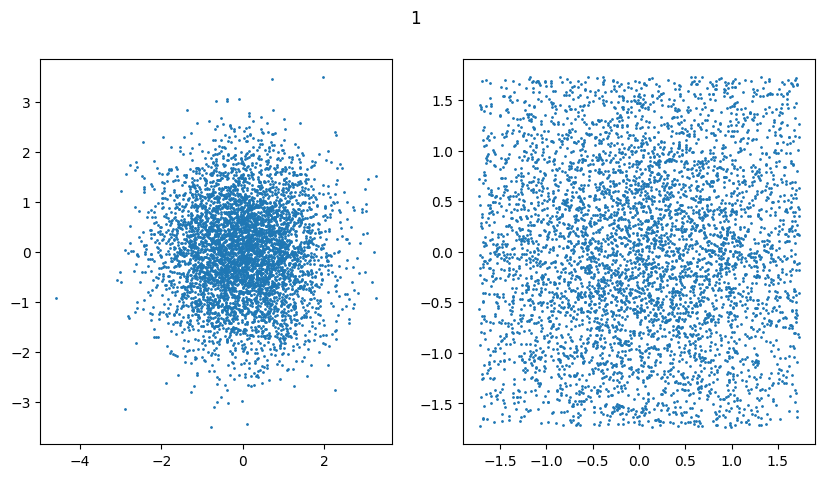

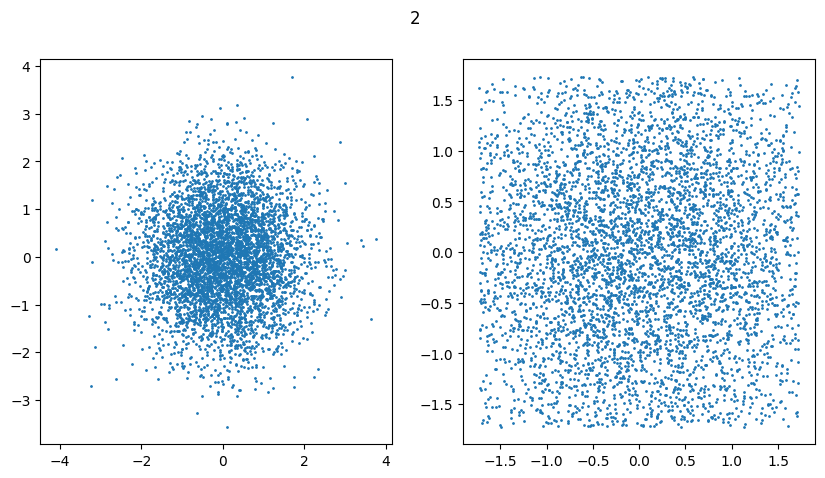

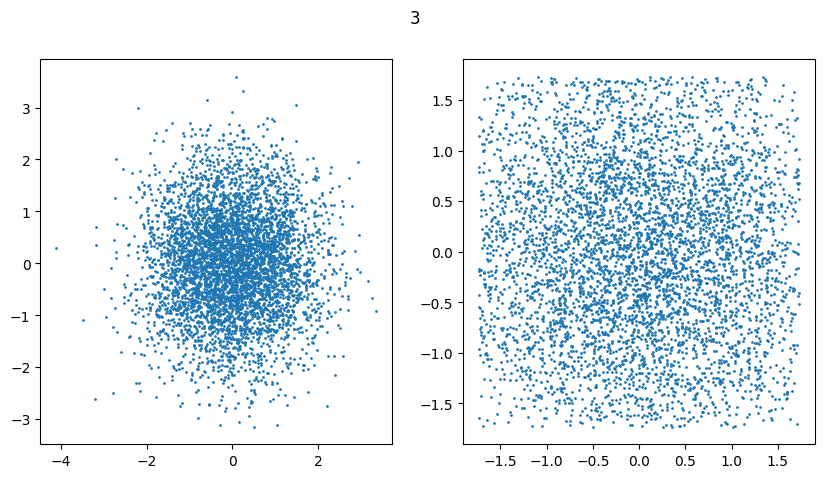

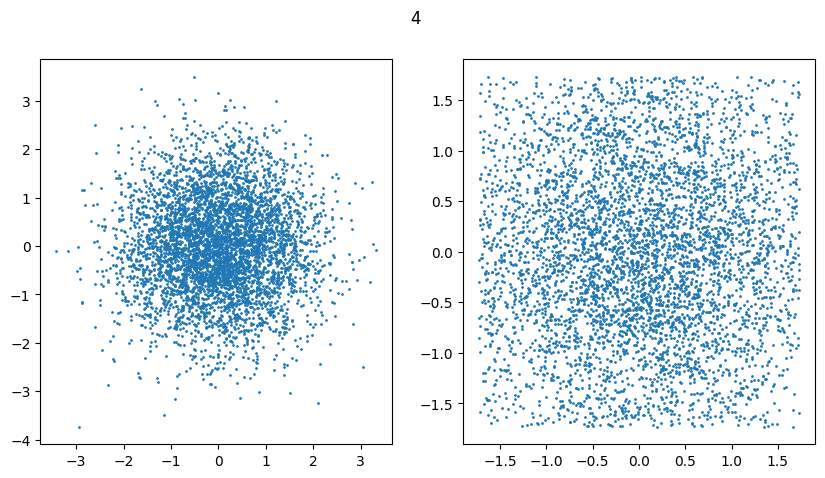

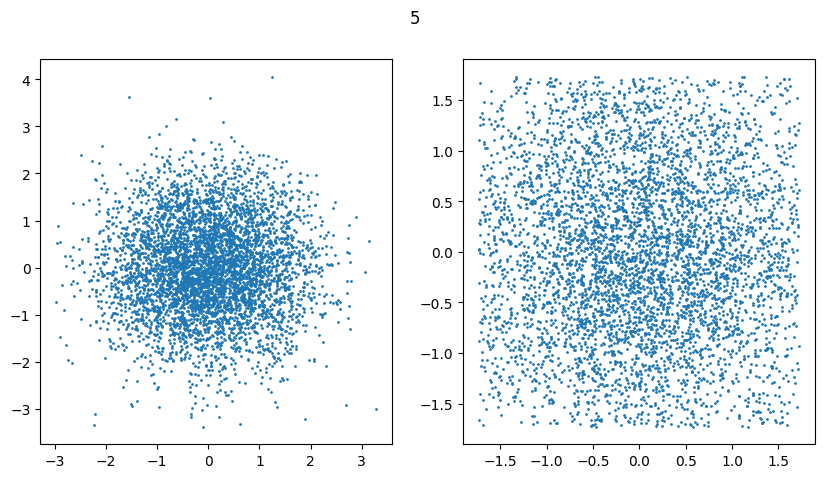

...

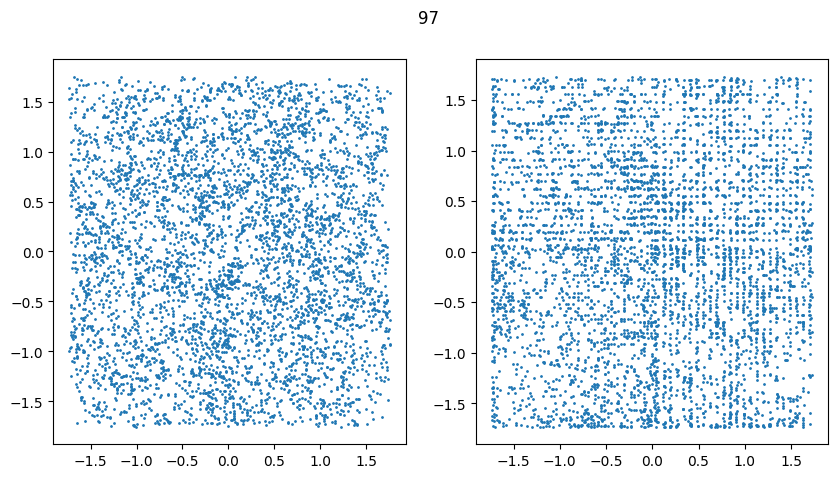

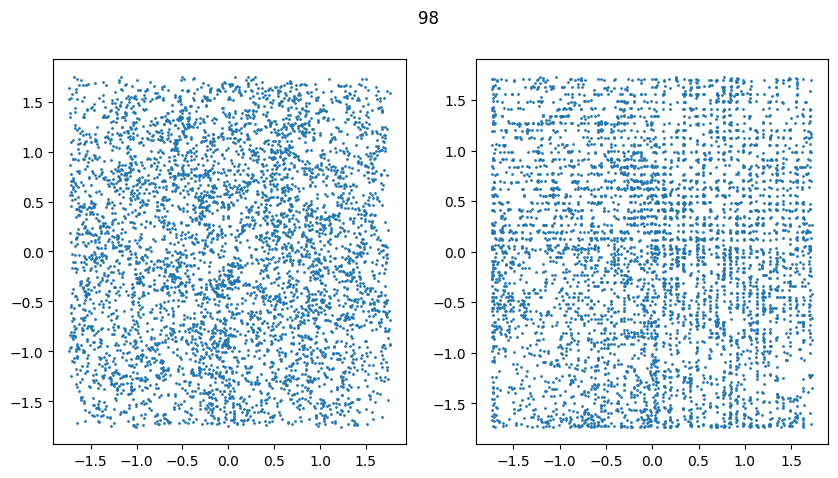

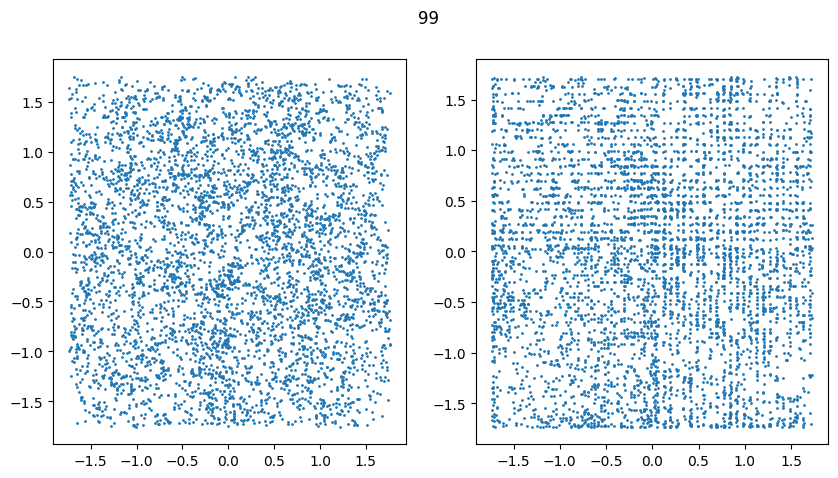

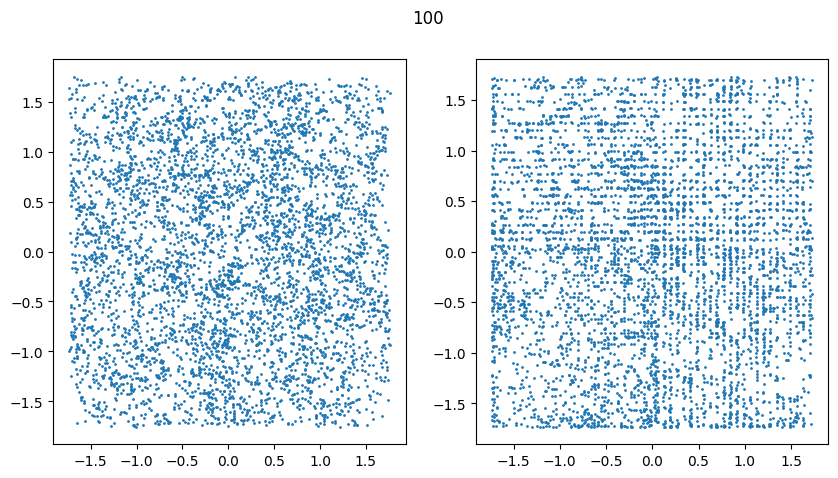

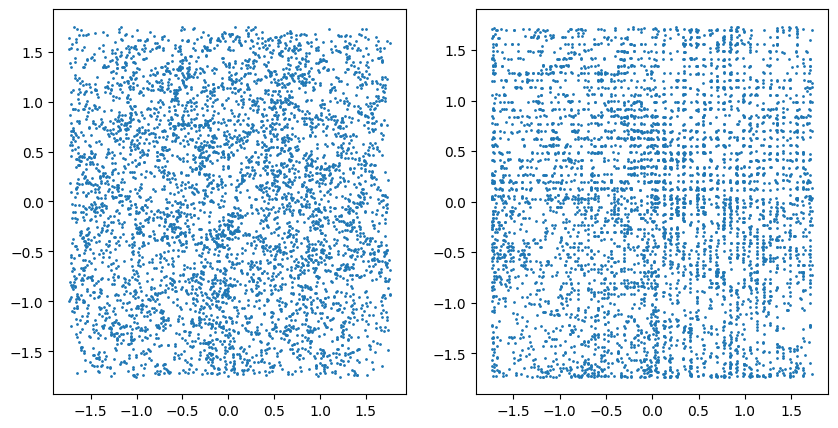

In [31]:
for i in range(0, len(zts_pbc),1):
    fig.suptitle(i)
    fig, ax = plt.subplots(ncols=2, figsize=(10,5))
    ax[0].scatter(zts[i][0,:,0], zts[i][0,:,1],s=1)
    ax[1].scatter(zts_pbc[i][0,:,0], zts_pbc[i][0,:,1],s=1)

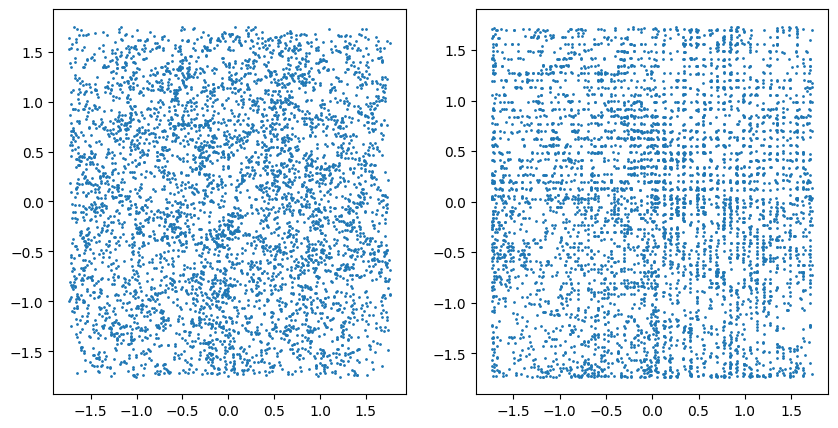

In [24]:
fig, ax = plt.subplots(ncols=2, figsize=(10,5))
ax[0].scatter(gen_sample[0][:,0], gen_sample[0][:,1],s=1)
ax[1].scatter(gen_sample_pbc[0][:,0], gen_sample_pbc[0][:,1],s=1)